In [1]:
import cv2
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import os
from sklearn.model_selection import KFold
import os
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import time
from contextlib import contextmanager # timer
from functools import partial
import cv2
import seaborn as sns
import SimpleITK as sitk
import matplotlib.pylab as plt
from sklearn.model_selection import KFold
import random
from skimage.transform import rescale, resize
from scipy.ndimage import rotate
import torch
from torch.utils import data
from torch.utils.data import DataLoader, Dataset
import SimpleITK as sitk
print(os.listdir("../input/"))
from skimage import data, img_as_float
from skimage import exposure

['kvasir-instrument-segmentation']


In [2]:
def gaussian_noise(img, mean=0, sigma=0.03):
    img = img.copy()
    noise = np.random.normal(mean, sigma, img.shape)
    mask_overflow_upper = img+noise >= 1.0
    mask_overflow_lower = img+noise < 0
    noise[mask_overflow_upper] = 1.0
    noise[mask_overflow_lower] = 0
    img += noise
    return img

#https://towardsdatascience.com/complete-image-augmentation-in-opencv-31a6b02694f5
def brightness(img, low, high):
    value = random.uniform(low, high)
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
    hsv = np.array(hsv, dtype = np.float64)
    hsv[:,:,1] = hsv[:,:,1]*value
    hsv[:,:,1][hsv[:,:,1]>255]  = 255
    hsv[:,:,2] = hsv[:,:,2]*value 
    hsv[:,:,2][hsv[:,:,2]>255]  = 255
    hsv = np.array(hsv, dtype = np.uint8)
    img = cv2.cvtColor(hsv, cv2.COLOR_HSV2BGR)
    return img

#https://towardsdatascience.com/complete-image-augmentation-in-opencv-31a6b02694f5
def fill(img, h, w):
    img = img.astype('float32')
    img = cv2.resize(img, (h, w), cv2.INTER_CUBIC)
    return img
def zoom(img, mask, value):
    if value > 1 or value < 0:
        print('Value for zoom should be less than 1 and greater than 0')
        return img, mask
    value = random.uniform(value, 1)
    h, w = img.shape[:2]
    h_taken = int(value*h)
    w_taken = int(value*w)
    h_start = random.randint(0, h-h_taken)
    w_start = random.randint(0, w-w_taken)
    img = img[h_start:h_start+h_taken, w_start:w_start+w_taken, :]
    img = fill(img, h, w)
    mask = mask[h_start:h_start+h_taken, w_start:w_start+w_taken, :]
    mask = fill(mask, h, w)
    return img, mask

# https://towardsdatascience.com/complete-image-augmentation-in-opencv-31a6b02694f5
def vertical_shift(img, mask, ratio=0.0):
    if ratio > 1 or ratio < 0:
        print('Value should be less than 1 and greater than 0')
        return img, mask
    ratio = random.uniform(-ratio, ratio)
    h, w = img.shape[:2]
    to_shift = h*ratio
    if ratio > 0:
        img = img[:, :int(w-to_shift), :]
        mask = mask[:, :int(w-to_shift), :]
    if ratio < 0:
        img = img[:, int(-1*to_shift):, :]
        mask = mask[:, int(-1*to_shift):, :]
    img = fill(img, h, w)
    mask = fill(mask, h, w)
    return img, mask

# https://towardsdatascience.com/complete-image-augmentation-in-opencv-31a6b02694f5 
def horizontal_shift(img, mask, ratio=0.0):
    if ratio > 1 or ratio < 0:
        print('Value should be less than 1 and greater than 0')
        return img, mask
    ratio = random.uniform(-ratio, ratio)
    h, w = img.shape[:2]
    to_shift = w*ratio
    if ratio > 0:
        img = img[:, :int(w-to_shift), :]
        mask = mask[:, :int(w-to_shift), :]
    if ratio < 0:
        img = img[:, int(-1*to_shift):, :]
        mask = mask[:, int(-1*to_shift):, :]
    img = fill(img, h, w)
    mask = fill(mask, h, w)
    return img,mask

In [3]:
def batch_generator(batch_size, gen_x): 
    batch_features = np.zeros((batch_size,256,256,3))
    batch_labels = np.zeros((batch_size,256,256,3)) 
    while True:
        for i in range(batch_size):
            batch_features[i] , batch_labels[i] = next(gen_x)
        yield batch_features, batch_labels

In [4]:
def generate_data(filelist, img_path, mask_path, gen_type = "train"):
    while True:
        for i in filelist:
            X_train = cv2.imread(img_path + i, cv2.IMREAD_COLOR )
            X_train = cv2.resize(X_train, (256,256), interpolation= cv2.INTER_LINEAR )
            i = i.split(".")[0] + ".png"
            y_mask = cv2.imread(mask_path + i, cv2.IMREAD_COLOR)
            y_mask = cv2.resize(y_mask, (256,256), interpolation= cv2.IMREAD_GRAYSCALE)
            _,y_mask = cv2.threshold(y_mask, 127, 255, cv2.THRESH_BINARY)
            y_train = (y_mask/255).astype(int)
            if gen_type == "train":
                # returns a random integer used to select augmentataion techniques for a given sample
                augment_num = np.random.randint(0,9)
                #augment_num = 0 
                if augment_num == 0:
                    # do nothing
                    X_train = X_train
                elif augment_num == 1:
                    #random noise
                    X_train = X_train + np.random.rand(X_train.shape[0], X_train.shape[1], X_train.shape[2])*np.random.randint(-100,100)
                elif augment_num == 2:
                    X_train = cv2.GaussianBlur(X_train,(random.randrange(1,50,2),random.randrange(1,50,2)), 0)
                elif augment_num == 3:
                    rot = np.random.randint(-45,45)
                    X_train = rotate(X_train,rot, reshape=False)
                    y_train = rotate(y_train,rot, reshape=False)
                elif augment_num == 4:
                    X_train = brightness(X_train,0.5,3)
                elif augment_num == 5:
                    X_train = np.fliplr(X_train)
                    y_train = np.fliplr(y_train)
                elif augment_num == 6:
                    X_train = np.flipud(X_train)
                    y_train = np.flipud(y_train)
                elif augment_num == 7:
                    hshift = round(random.uniform(0.1, 0.3),3)
                    X_train, y_train = horizontal_shift(X_train, y_train, hshift)
                elif augment_num == 8:
                    vshift = round(random.uniform(0.1, 0.3),3)
                    X_train, y_train = vertical_shift(X_train, y_train, vshift)
                elif augment_num == 9:
                    zoom_rate = round(random.uniform(0.8, 0.95),3)
                    X_train, y_train = zoom(X_train, y_train, zoom_rate)
                elif augment_num == 10:
                    #contrast
                    X_train = exposure.equalize_adapthist(X_train.astype(int), clip_limit=0.03)  
                elif augment_num == 11:
                    #contrast
                    X_train = exposure.equalize_hist(X_train.astype(int))  
            yield X_train, y_train

In [5]:
def generate_data_pred(filelist, img_path, mask_path, gen_type = "train"):
    while True:
        for i in filelist:
            original_img = cv2.imread(img_path + i, cv2.IMREAD_COLOR )
            X_train = cv2.resize(original_img, (256,256), interpolation= cv2.INTER_LINEAR )
            if gen_type == "train":
                X_train = X_train * np.random.choice([1,1,1,np.random.rand(256, 256,3)])
            i = i.split(".")[0] + ".png"
            original_mask = cv2.imread(mask_path + i, cv2.IMREAD_COLOR)
            y_mask = cv2.resize(original_mask, (256,256), interpolation= cv2.IMREAD_GRAYSCALE)
            _,y_mask = cv2.threshold(y_mask, 127, 255, cv2.THRESH_BINARY)
            y_mask = (y_mask/255).astype(int)
            yield original_img, original_mask, X_train, y_mask

In [6]:
def dice_score(mask_gt, mask_pred):
    """Computes soerensen-dice coefficient.

    compute the soerensen-dice coefficient between the ground truth mask `mask_gt`
    and the predicted mask `mask_pred`.

    Args:
    mask_gt: 3-dim Numpy array of type bool. The ground truth mask.
    mask_pred: 3-dim Numpy array of type bool. The predicted mask.

    Returns:
    the dice coeffcient as float. If both masks are empty, the result is NaN.
    """
    volume_sum = mask_gt.sum() + mask_pred.sum()
    if volume_sum == 0:
        return np.NaN
    volume_intersect = (mask_gt & mask_pred).sum()
    return 2*volume_intersect / volume_sum 

In [7]:
from keras import backend as K
# From: https://gist.github.com/wassname/7793e2058c5c9dacb5212c0ac0b18a8a
def dice_coef(y_true, y_pred, smooth=1):
    """
    Dice = (2*|X & Y|)/ (|X|+ |Y|)
         =  2*sum(|A*B|)/(sum(A^2)+sum(B^2))
    ref: https://arxiv.org/pdf/1606.04797v1.pdf
    """
    intersection = K.sum(K.abs(y_true * y_pred), axis=-1)
    return (2. * intersection + smooth) / (K.sum(K.square(y_true),-1) + K.sum(K.square(y_pred),-1) + smooth)

def dice_coef_loss(y_true, y_pred):
    return 1-dice_coef(y_true, y_pred)

Using TensorFlow backend.


In [8]:
def jacard_coef(y_true, y_pred):
    y_true_f = K.flatten(y_true)
    y_pred_f = K.flatten(y_pred)
    intersection = K.sum(y_true_f * y_pred_f)
    return (intersection + 1.0) / (K.sum(y_true_f) + K.sum(y_pred_f) - intersection + 1.0)


def jacard_coef_loss(y_true, y_pred):
    return 1-jacard_coef(y_true, y_pred)

In [9]:
from tensorflow.keras import layers
import tensorflow as tf


def get_model(img_size, num_classes):

    inputs = tf.keras.Input(shape=img_size + (3,))
    #inputs = tf.keras.Input(shape=(256,256,3))
    #inputs = tf.keras.Input(shape=img_size + (1,))
    ### [First half of the network: downsampling inputs] ###

    # Entry block
    x = layers.Conv2D(32, 3, strides=2, padding="same")(inputs)
    x = layers.BatchNormalization()(x)
    x = layers.Activation("relu")(x)

    previous_block_activation = x  # Set aside residual

    # Blocks 1, 2, 3 are identical apart from the feature depth.
    for filters in [64, 128, 256]:
        x = layers.Activation("relu")(x)
        x = layers.SeparableConv2D(filters, 3, padding="same")(x)
        x = layers.BatchNormalization()(x)

        x = layers.Activation("relu")(x)
        x = layers.SeparableConv2D(filters, 3, padding="same")(x)
        x = layers.BatchNormalization()(x)

        x = layers.MaxPooling2D(3, strides=2, padding="same")(x)

        # Project residual
        residual = layers.Conv2D(filters, 1, strides=2, padding="same")(
            previous_block_activation
        )
        x = layers.add([x, residual])  # Add back residual
        previous_block_activation = x  # Set aside next residual

    ### [Second half of the network: upsampling inputs] ###

    for filters in [256, 128, 64, 32]:
        x = layers.Activation("relu")(x)
        x = layers.Conv2DTranspose(filters, 3, padding="same")(x)
        x = layers.BatchNormalization()(x)

        x = layers.Activation("relu")(x)
        x = layers.Conv2DTranspose(filters, 3, padding="same")(x)
        x = layers.BatchNormalization()(x)

        x = layers.UpSampling2D(2)(x)

        # Project residual
        residual = layers.UpSampling2D(2)(previous_block_activation)
        residual = layers.Conv2D(filters, 1, padding="same")(residual)
        x = layers.add([x, residual])  # Add back residual
        previous_block_activation = x  # Set aside next residual

    # Add a per-pixel classification layer
    outputs = layers.Conv2D(num_classes, 3, activation="sigmoid", padding="same")(x)

    # Define the model
    model = tf.keras.Model(inputs, outputs)
    model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.001), loss=jacard_coef_loss, metrics = [jacard_coef, dice_coef])
    return model


# Free up RAM in case the model definition cells were run multiple times
tf.keras.backend.clear_session()

# Build model
#model = get_model(img_size, num_classes)

#model.summary()

In [10]:
reduce_lr = tf.keras.callbacks.ReduceLROnPlateau(
    monitor='val_loss', factor=0.1, patience=3, verbose=1, mode='min',
    min_delta=0.0001, cooldown=4, min_lr=0
)

In [11]:
!pip install segmentation-models==1.0.1

In [12]:
import segmentation_models as sm

Segmentation Models: using `keras` framework.


In [13]:
!pip install neptune-client

     |████████████████████████████████| 276kB 817kB/s 
     |████████████████████████████████| 153kB 11.0MB/s 
     |████████████████████████████████| 174kB 10.8MB/s 
     |████████████████████████████████| 133kB 11.4MB/s 
     |████████████████████████████████| 71kB 13.3MB/s 
     |████████████████████████████████| 133kB 11.4MB/s 
     |████████████████████████████████| 71kB 13.0MB/s 
     |████████████████████████████████| 7.9MB 11.5MB/s 
     |████████████████████████████████| 81kB 29.6MB/s 
  Created wheel for neptune-client: filename=neptune_client-0.11.0-py2.py3-none-any.whl size=465803 sha256=949c681c430a9d3f213cb6052fe1c1c6aecc4578b8e70a9e45844c689a3256d7
  Stored in directory: /root/.cache/pip/wheels/63/87/d0/853bd5c944c55c458935ac35da8eb5f9e0d1d428725a549666
  Created wheel for strict-rfc3339: filename=strict_rfc3339-0.7-cp36-none-any.whl size=18121 sha256=cd9777dc5c4cb5329f858d129ed78b73a64e55a4a88c7643e1606ad7b031f848
  Stored in directory: /root/.cache/pip/wheels/bb/af/c9/

In [14]:
import neptune.new as neptune
from sklearn.metrics import jaccard_score
import time

/opt/conda/lib/python3.6/site-packages/neptune/new/internal/utils/git.py:34: UserWarning: GitPython could not be initialized
  warnings.warn("GitPython could not be initialized")


https://app.neptune.ai/SSCP/HyperKvasir/e/HYPER-93
Remember to stop your run once you’ve finished logging your metadata (https://docs.neptune.ai/api-reference/run#stop). It will be stopped automatically only when the notebook kernel/interactive console is terminated.
27164672/27164032 [==============================] - 0s 0us/step
Epoch 1/35
18/17 [==============================] - 51s 3s/step - loss: 0.8334 - jacard_coef: 0.1666 - dice_coef: 0.6654 - val_loss: 0.9019 - val_jacard_coef: 0.0982 - val_dice_coef: 0.3436
Epoch 2/35
18/17 [==============================] - 17s 947ms/step - loss: 0.7038 - jacard_coef: 0.2962 - dice_coef: 0.8513 - val_loss: 0.8771 - val_jacard_coef: 0.1225 - val_dice_coef: 0.4701
Epoch 3/35
18/17 [==============================] - 19s 1s/step - loss: 0.5041 - jacard_coef: 0.4959 - dice_coef: 0.9573 - val_loss: 0.8349 - val_jacard_coef: 0.1670 - val_dice_coef: 0.6445
Epoch 4/35
18/17 [==============================] - 19s 1s/step - loss: 0.3078 - jacard_coef: 

/opt/conda/lib/python3.6/site-packages/sklearn/metrics/classification.py:778: UndefinedMetricWarning: Jaccard is ill-defined and being set to 0.0 in labels with no true or predicted samples.
  'true or predicted', average, ('jaccard',))


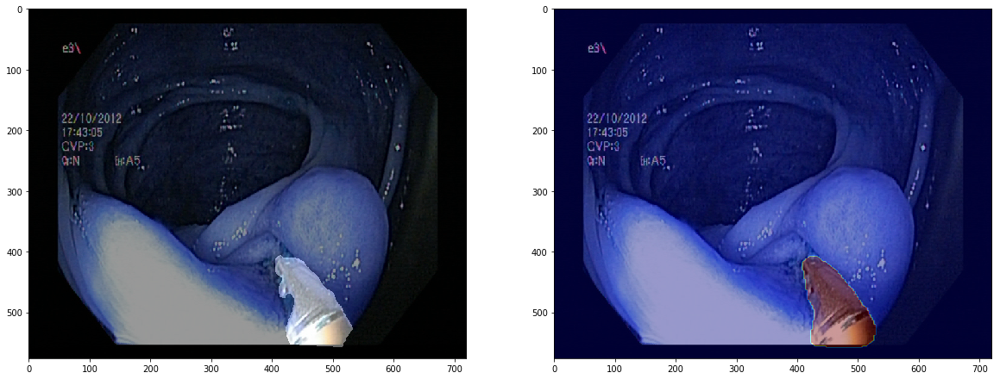

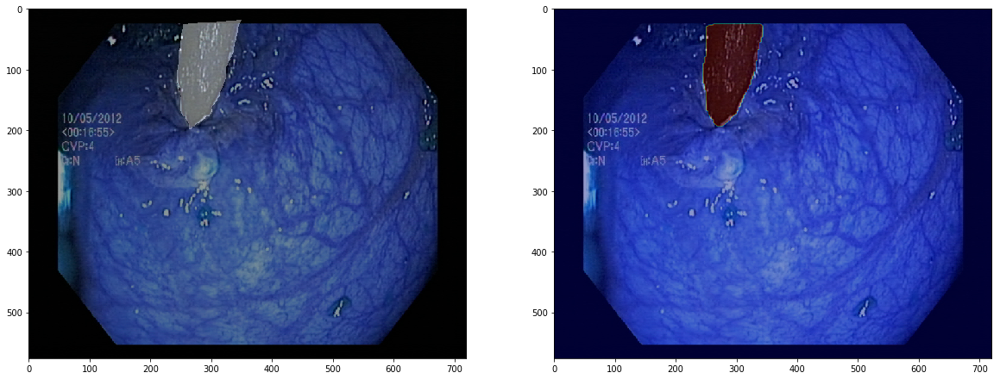

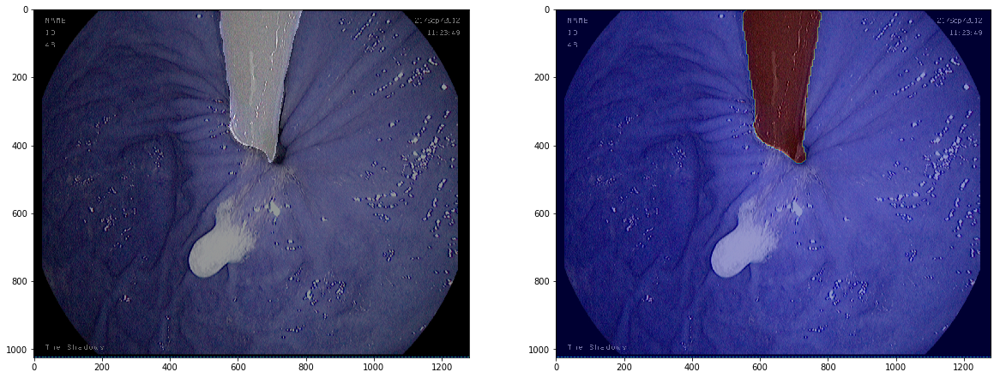

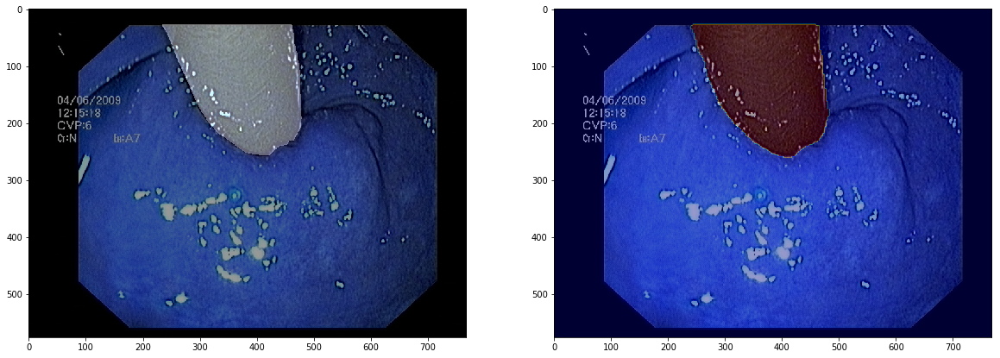

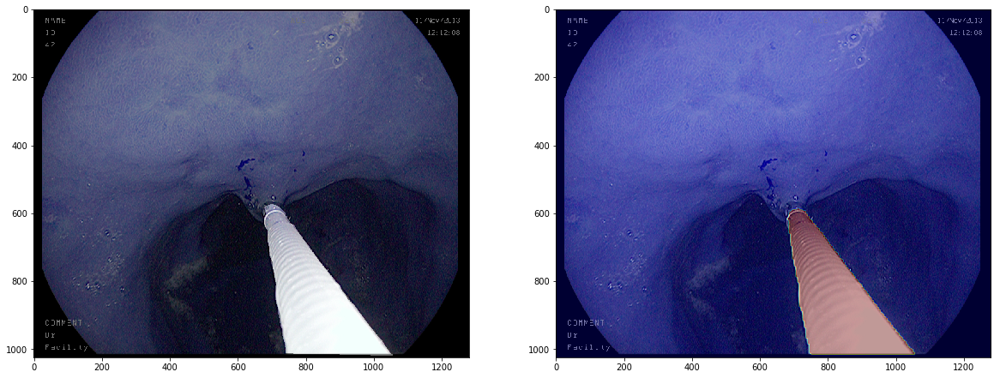

--------------------------------------
Mean validation DICE (on resized data): 0.957666382973208
Mean validation DICE (on original data): 0.9503984947687889
--------------------------------------
Mean validation Jaccard (on resized data): 0.29229451035305964
Mean validation Jaccard (on original data): 0.2854768203688766
--------------------------------------
Runtime: 0.22467994689941406 sec
Epoch 1/35
18/17 [==============================] - 46s 3s/step - loss: 0.8142 - jacard_coef: 0.1858 - dice_coef: 0.7431 - val_loss: 0.8774 - val_jacard_coef: 0.1175 - val_dice_coef: 0.3387
Epoch 2/35
18/17 [==============================] - 15s 827ms/step - loss: 0.5882 - jacard_coef: 0.4118 - dice_coef: 0.9307 - val_loss: 0.7734 - val_jacard_coef: 0.2304 - val_dice_coef: 0.7521
Epoch 3/35
18/17 [==============================] - 20s 1s/step - loss: 0.3817 - jacard_coef: 0.6183 - dice_coef: 0.9781 - val_loss: 0.8503 - val_jacard_coef: 0.1450 - val_dice_coef: 0.4998
Epoch 4/35
18/17 [===============

/opt/conda/lib/python3.6/site-packages/sklearn/metrics/classification.py:778: UndefinedMetricWarning: Jaccard is ill-defined and being set to 0.0 in labels with no true or predicted samples.
  'true or predicted', average, ('jaccard',))


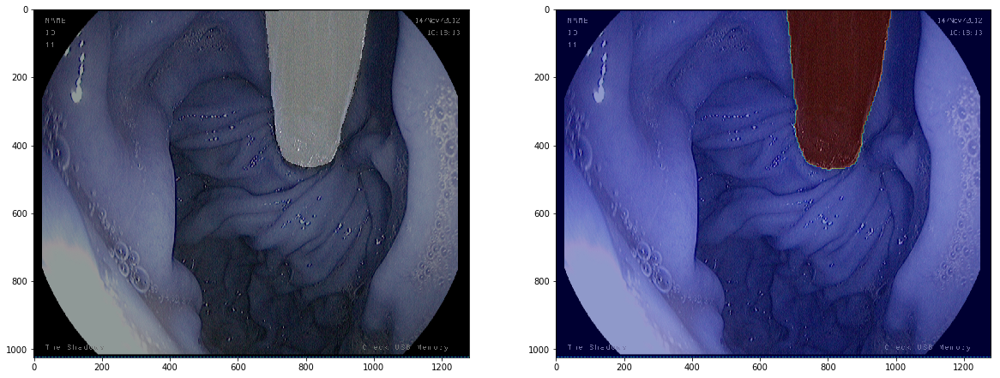

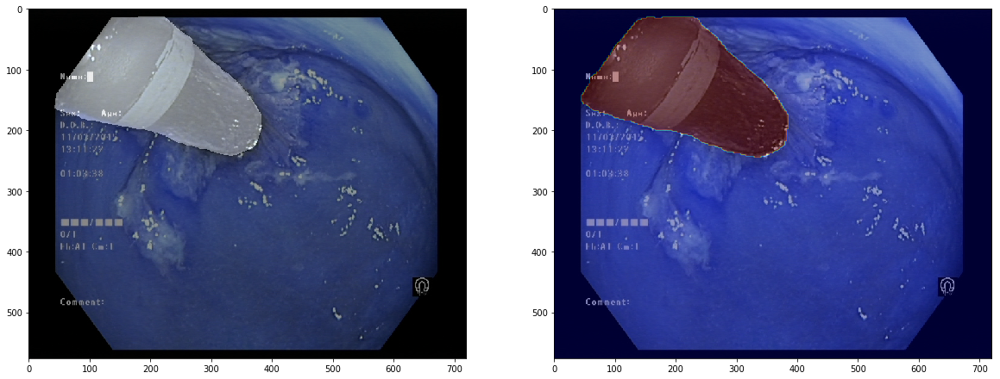

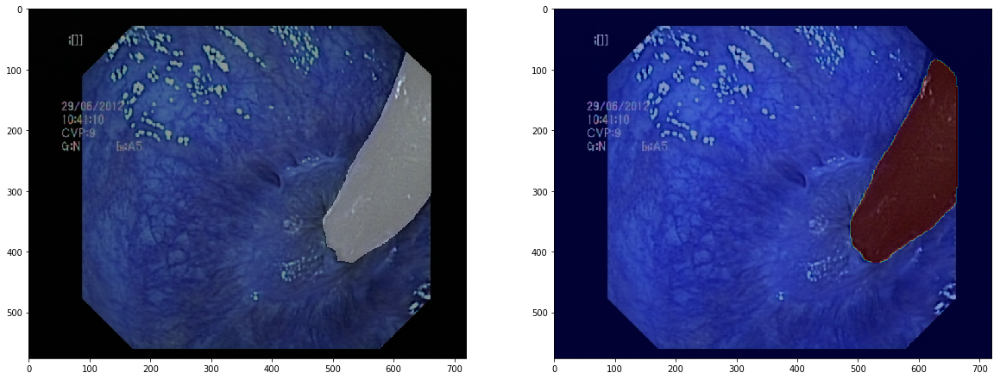

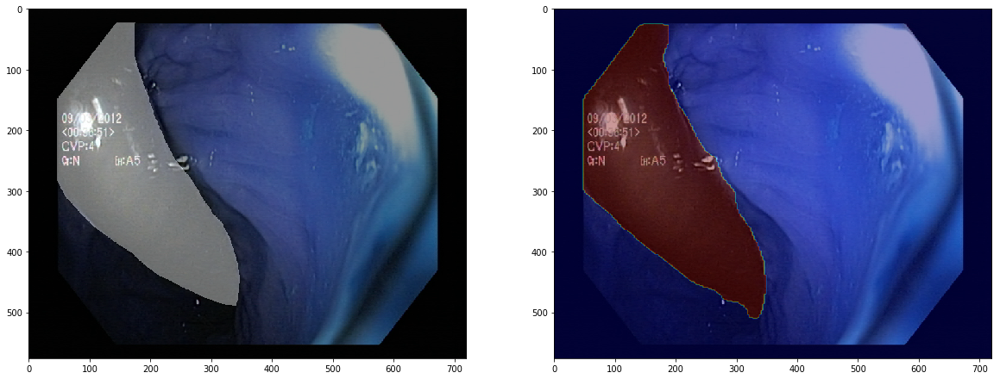

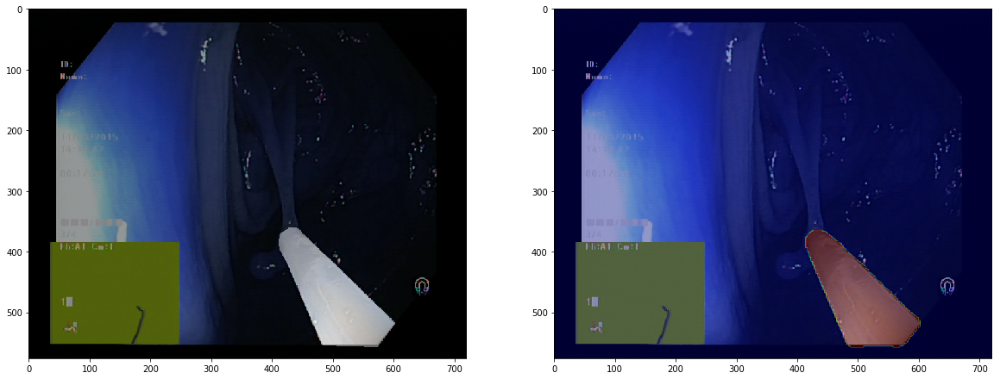

--------------------------------------
Mean validation DICE (on resized data): 0.9674391743041934
Mean validation DICE (on original data): 0.9601223090689435
--------------------------------------
Mean validation Jaccard (on resized data): 0.3390148869082687
Mean validation Jaccard (on original data): 0.3318613086618666
--------------------------------------
Runtime: 0.10502099990844727 sec
Epoch 1/35
18/17 [==============================] - 44s 2s/step - loss: 0.8289 - jacard_coef: 0.1711 - dice_coef: 0.6489 - val_loss: 0.9147 - val_jacard_coef: 0.0893 - val_dice_coef: 0.3221
Epoch 2/35
18/17 [==============================] - 13s 734ms/step - loss: 0.7013 - jacard_coef: 0.2987 - dice_coef: 0.8442 - val_loss: 0.8245 - val_jacard_coef: 0.1719 - val_dice_coef: 0.5971
Epoch 3/35
18/17 [==============================] - 19s 1s/step - loss: 0.5076 - jacard_coef: 0.4924 - dice_coef: 0.9557 - val_loss: 0.7825 - val_jacard_coef: 0.2165 - val_dice_coef: 0.7607
Epoch 4/35
18/17 [===============

/opt/conda/lib/python3.6/site-packages/sklearn/metrics/classification.py:778: UndefinedMetricWarning: Jaccard is ill-defined and being set to 0.0 in labels with no true or predicted samples.
  'true or predicted', average, ('jaccard',))


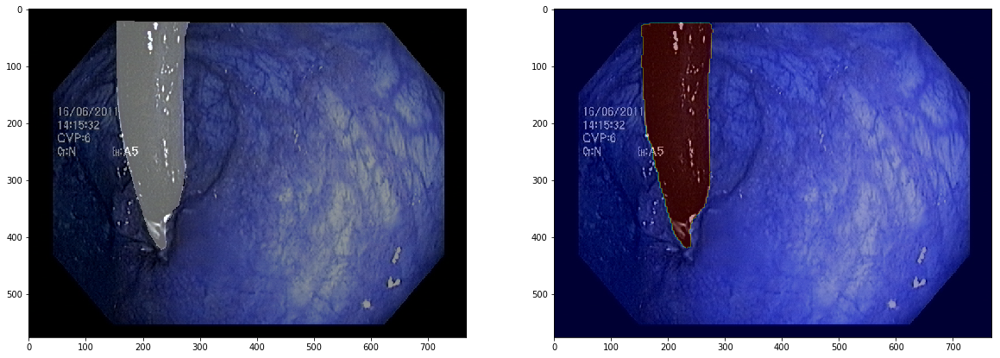

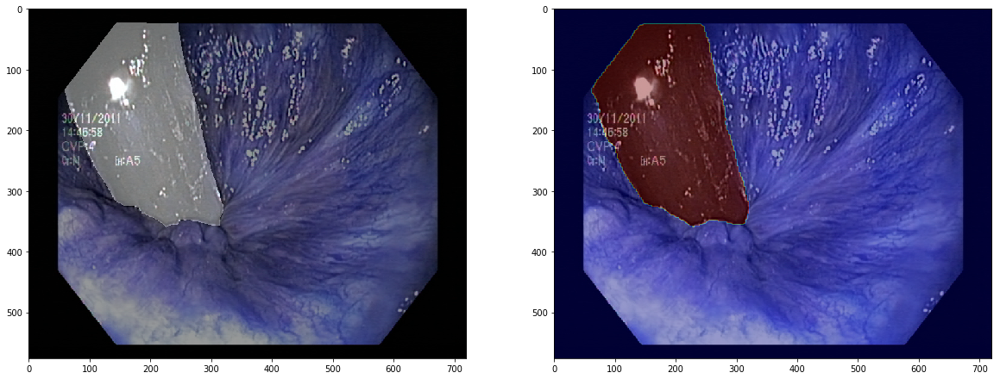

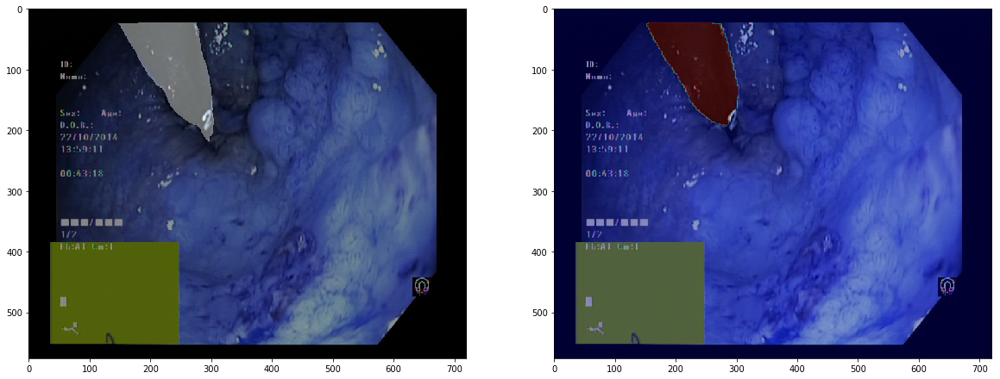

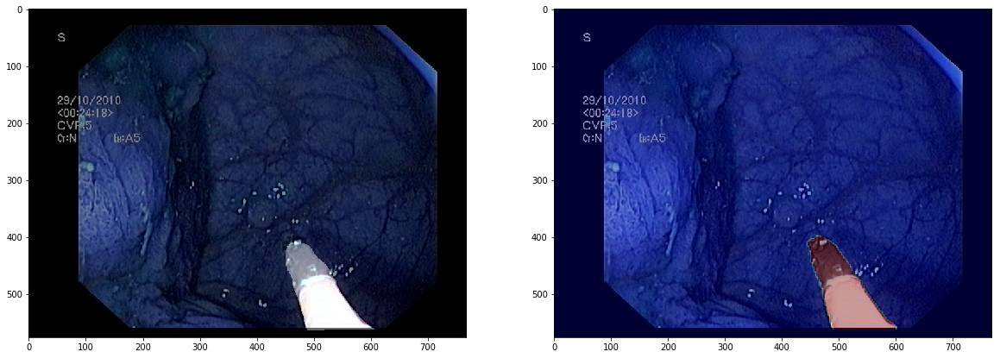

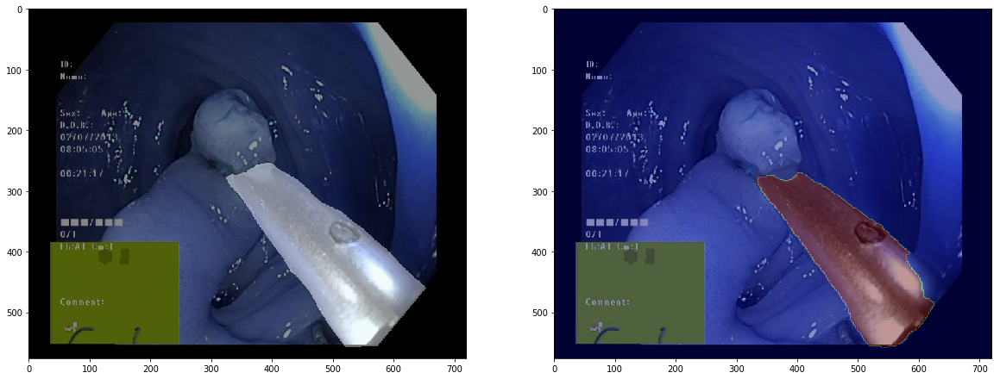

--------------------------------------
Mean validation DICE (on resized data): 0.9498914579743929
Mean validation DICE (on original data): 0.9430300052120345
--------------------------------------
Mean validation Jaccard (on resized data): 0.27742167743380197
Mean validation Jaccard (on original data): 0.2706787575990433
--------------------------------------
Runtime: 0.1066901683807373 sec
Epoch 1/35
18/17 [==============================] - 45s 3s/step - loss: 0.8204 - jacard_coef: 0.1796 - dice_coef: 0.7119 - val_loss: 0.8986 - val_jacard_coef: 0.1024 - val_dice_coef: 0.3377
Epoch 2/35
18/17 [==============================] - 12s 669ms/step - loss: 0.6455 - jacard_coef: 0.3545 - dice_coef: 0.9030 - val_loss: 0.8319 - val_jacard_coef: 0.1714 - val_dice_coef: 0.6606
Epoch 3/35
18/17 [==============================] - 18s 1s/step - loss: 0.3943 - jacard_coef: 0.6057 - dice_coef: 0.9767 - val_loss: 0.7851 - val_jacard_coef: 0.2226 - val_dice_coef: 0.7524
Epoch 4/35
18/17 [===============

/opt/conda/lib/python3.6/site-packages/sklearn/metrics/classification.py:778: UndefinedMetricWarning: Jaccard is ill-defined and being set to 0.0 in labels with no true or predicted samples.
  'true or predicted', average, ('jaccard',))


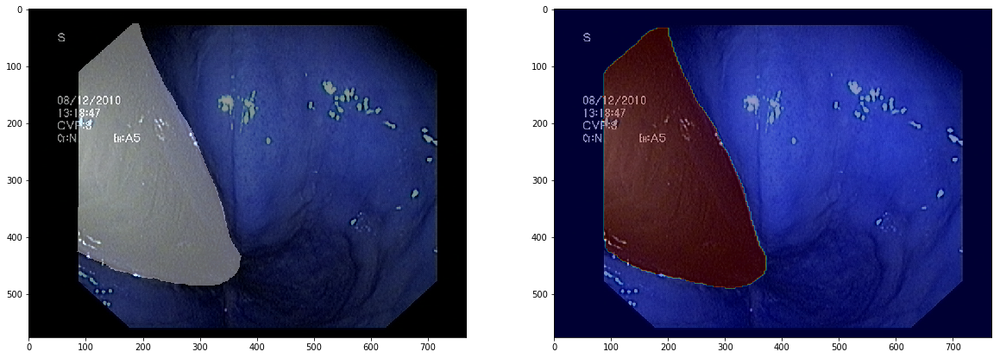

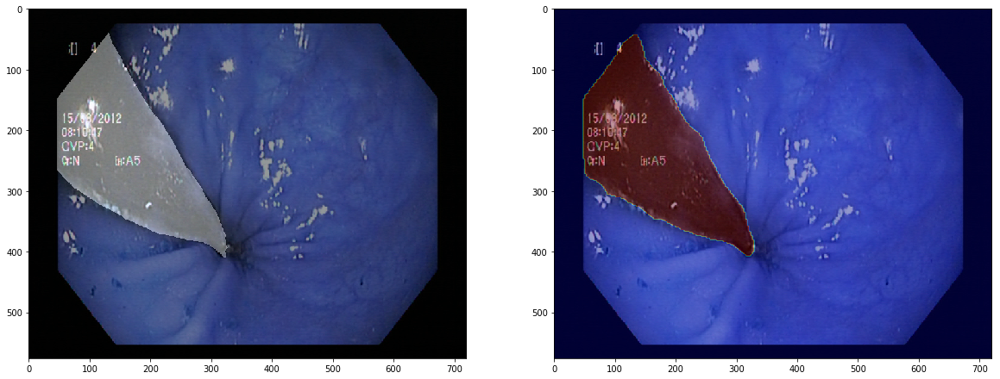

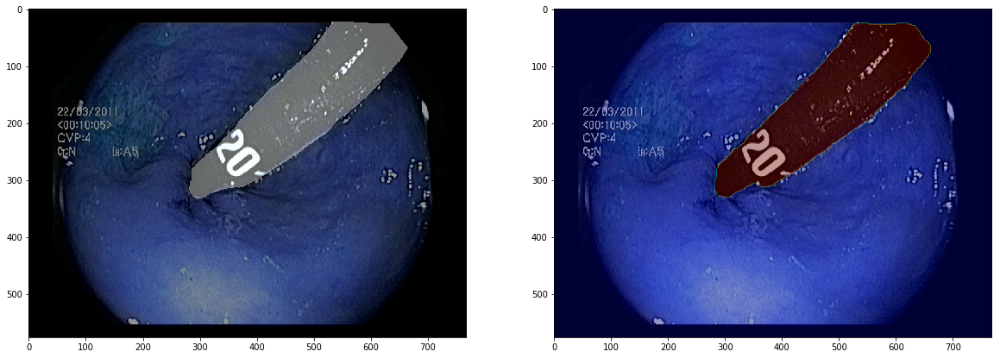

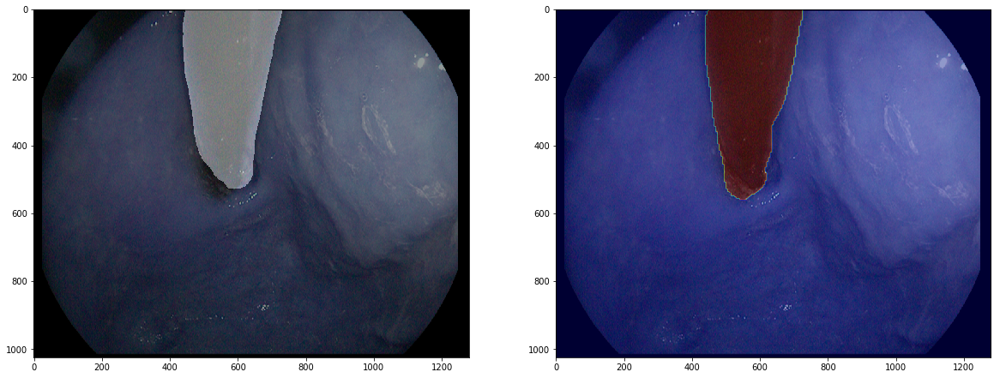

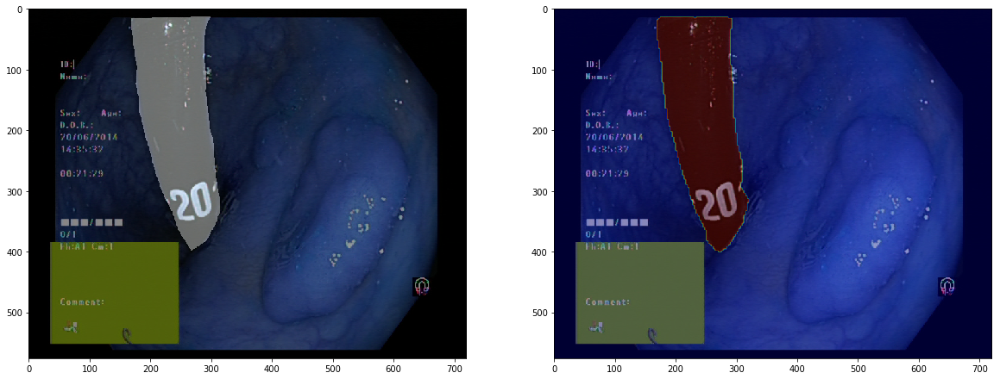

--------------------------------------
Mean validation DICE (on resized data): 0.9258356908567043
Mean validation DICE (on original data): 0.9192039678293744
--------------------------------------
Mean validation Jaccard (on resized data): 0.27412070277475553
Mean validation Jaccard (on original data): 0.26778731410888723
--------------------------------------
Runtime: 0.1157691478729248 sec
Epoch 1/35
18/17 [==============================] - 47s 3s/step - loss: 0.8422 - jacard_coef: 0.1578 - dice_coef: 0.6310 - val_loss: 0.8952 - val_jacard_coef: 0.1005 - val_dice_coef: 0.3360
Epoch 2/35
18/17 [==============================] - 11s 620ms/step - loss: 0.7563 - jacard_coef: 0.2437 - dice_coef: 0.7914 - val_loss: 0.8656 - val_jacard_coef: 0.1331 - val_dice_coef: 0.4781
Epoch 3/35
18/17 [==============================] - 20s 1s/step - loss: 0.6285 - jacard_coef: 0.3715 - dice_coef: 0.9049 - val_loss: 0.8105 - val_jacard_coef: 0.1882 - val_dice_coef: 0.6526
Epoch 4/35
18/17 [==============

/opt/conda/lib/python3.6/site-packages/sklearn/metrics/classification.py:778: UndefinedMetricWarning: Jaccard is ill-defined and being set to 0.0 in labels with no true or predicted samples.
  'true or predicted', average, ('jaccard',))


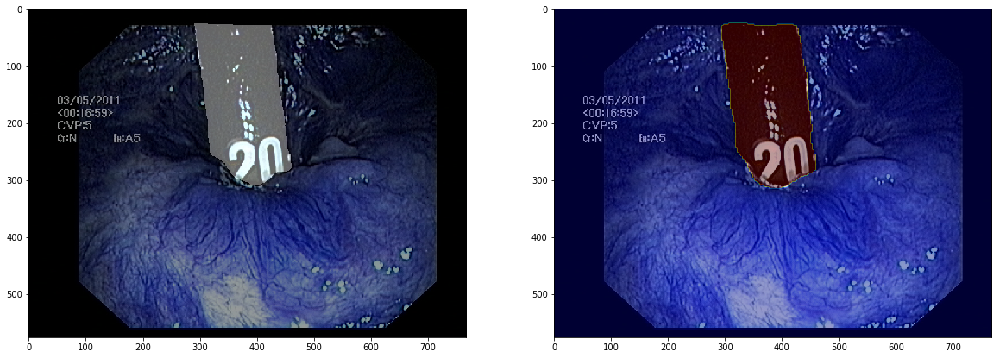

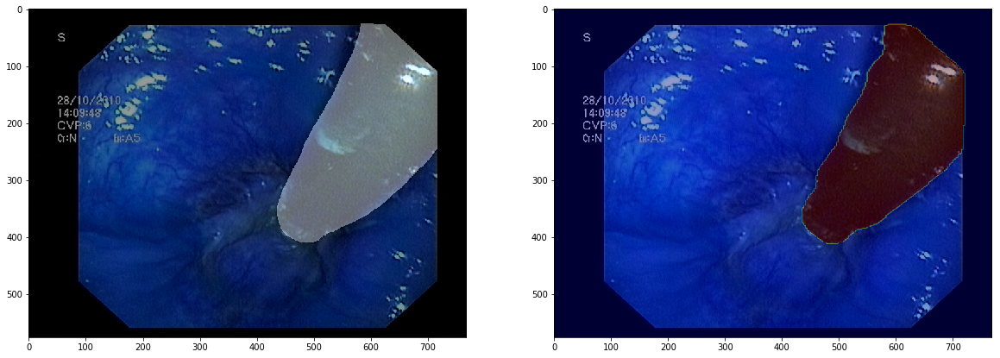

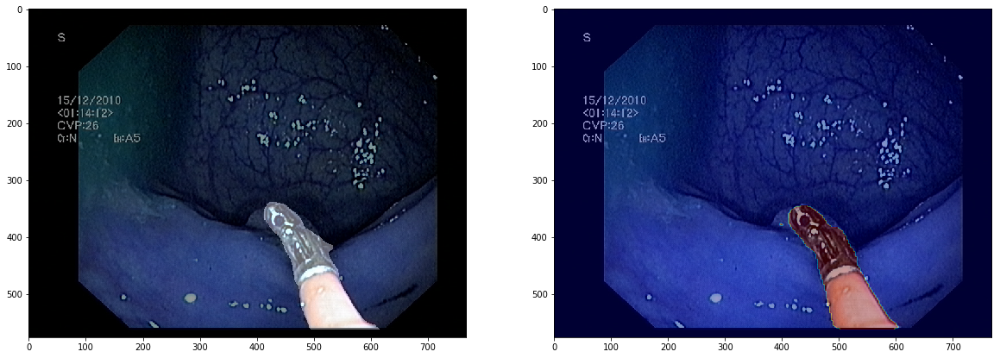

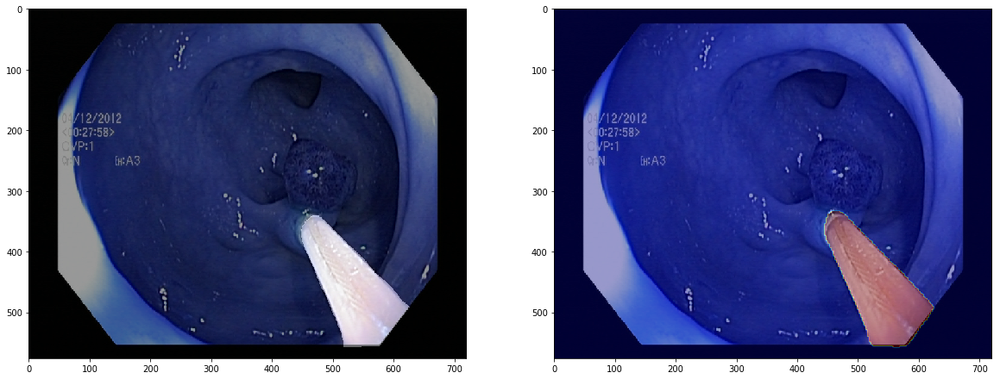

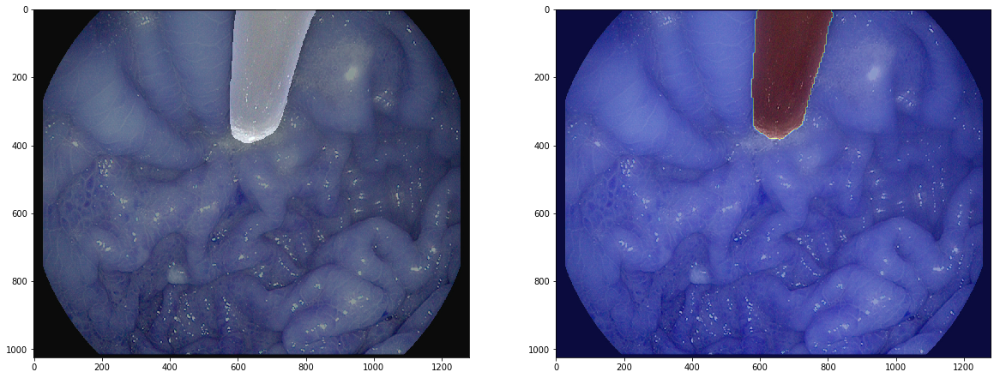

--------------------------------------
Mean validation DICE (on resized data): 0.9387526904556004
Mean validation DICE (on original data): 0.9339224122893527
--------------------------------------
Mean validation Jaccard (on resized data): 0.2888776860027625
Mean validation Jaccard (on original data): 0.28385435500380085
--------------------------------------
Runtime: 0.1044917106628418 sec
Epoch 1/35
18/17 [==============================] - 48s 3s/step - loss: 0.8301 - jacard_coef: 0.1699 - dice_coef: 0.6468 - val_loss: 0.8974 - val_jacard_coef: 0.1070 - val_dice_coef: 0.3302
Epoch 2/35
18/17 [==============================] - 11s 627ms/step - loss: 0.7129 - jacard_coef: 0.2871 - dice_coef: 0.8467 - val_loss: 0.7956 - val_jacard_coef: 0.2126 - val_dice_coef: 0.7221
Epoch 3/35
18/17 [==============================] - 19s 1s/step - loss: 0.5275 - jacard_coef: 0.4725 - dice_coef: 0.9552 - val_loss: 0.7488 - val_jacard_coef: 0.2667 - val_dice_coef: 0.8807
Epoch 4/35
18/17 [===============

/opt/conda/lib/python3.6/site-packages/sklearn/metrics/classification.py:778: UndefinedMetricWarning: Jaccard is ill-defined and being set to 0.0 in labels with no true or predicted samples.
  'true or predicted', average, ('jaccard',))


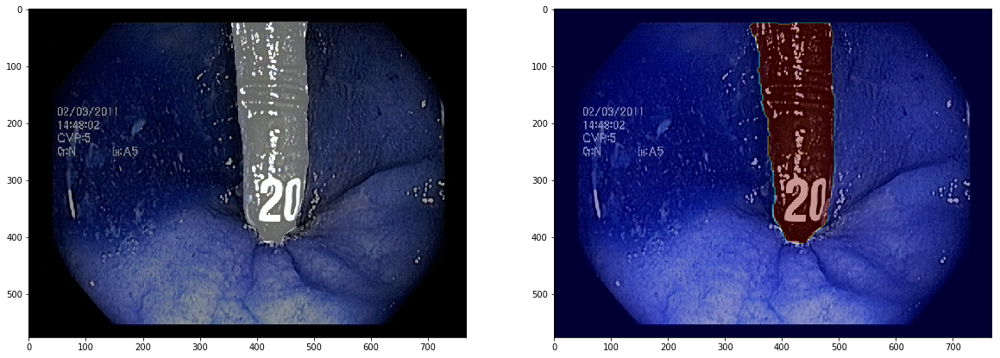

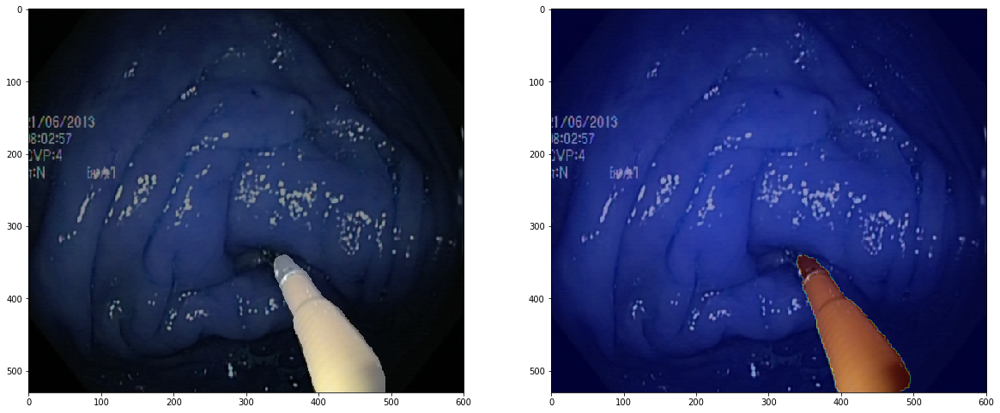

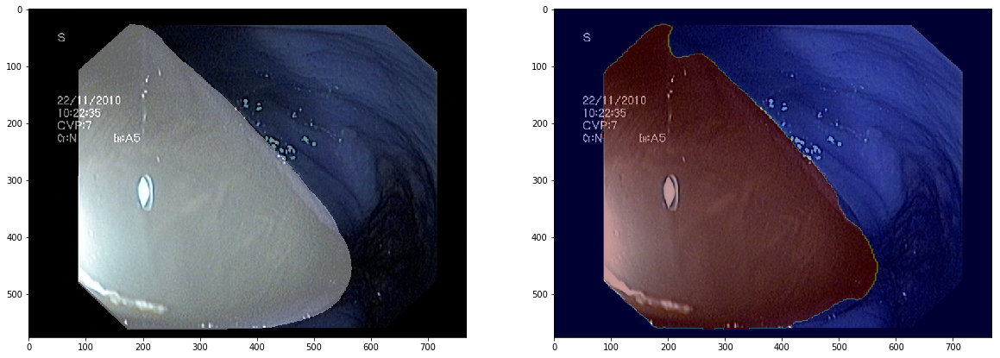

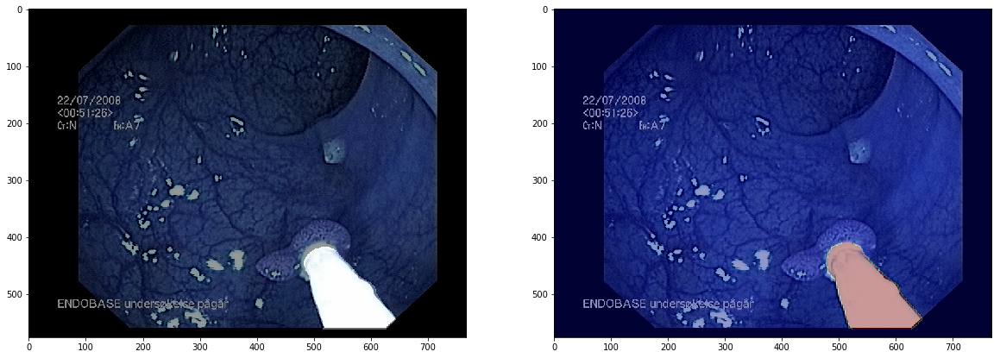

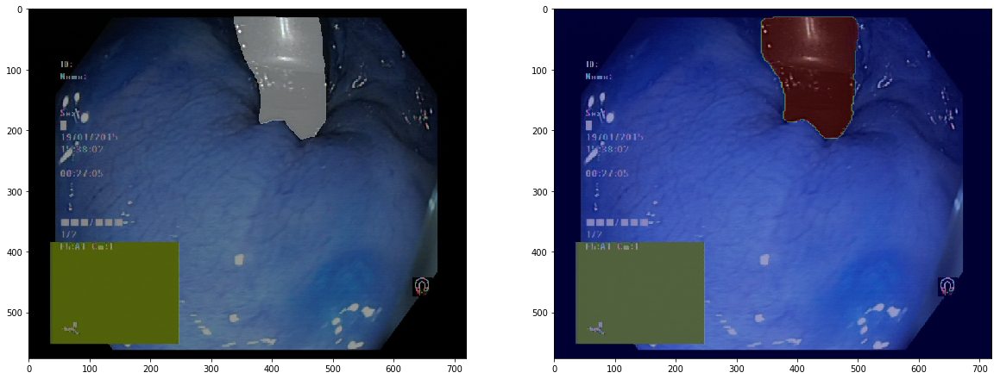

--------------------------------------
Mean validation DICE (on resized data): 0.9039384324353987
Mean validation DICE (on original data): 0.896525560045576
--------------------------------------
Mean validation Jaccard (on resized data): 0.27980438058513124
Mean validation Jaccard (on original data): 0.2727285719331434
--------------------------------------
Runtime: 0.13934016227722168 sec
Epoch 1/35
18/17 [==============================] - 51s 3s/step - loss: 0.8487 - jacard_coef: 0.1513 - dice_coef: 0.5911 - val_loss: 0.8939 - val_jacard_coef: 0.1010 - val_dice_coef: 0.3377
Epoch 2/35
18/17 [==============================] - 11s 608ms/step - loss: 0.7825 - jacard_coef: 0.2175 - dice_coef: 0.7372 - val_loss: 0.8270 - val_jacard_coef: 0.1745 - val_dice_coef: 0.6687
Epoch 3/35
18/17 [==============================] - 20s 1s/step - loss: 0.6605 - jacard_coef: 0.3395 - dice_coef: 0.8836 - val_loss: 0.6611 - val_jacard_coef: 0.3387 - val_dice_coef: 0.8741
Epoch 4/35
18/17 [===============

/opt/conda/lib/python3.6/site-packages/sklearn/metrics/classification.py:778: UndefinedMetricWarning: Jaccard is ill-defined and being set to 0.0 in labels with no true or predicted samples.
  'true or predicted', average, ('jaccard',))


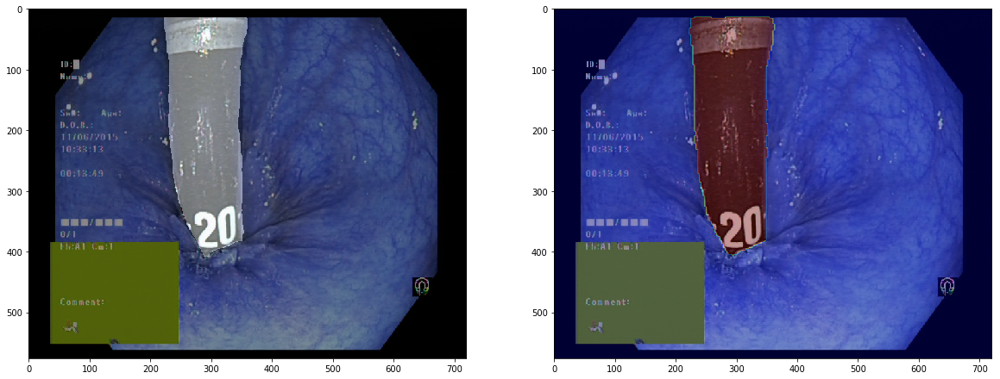

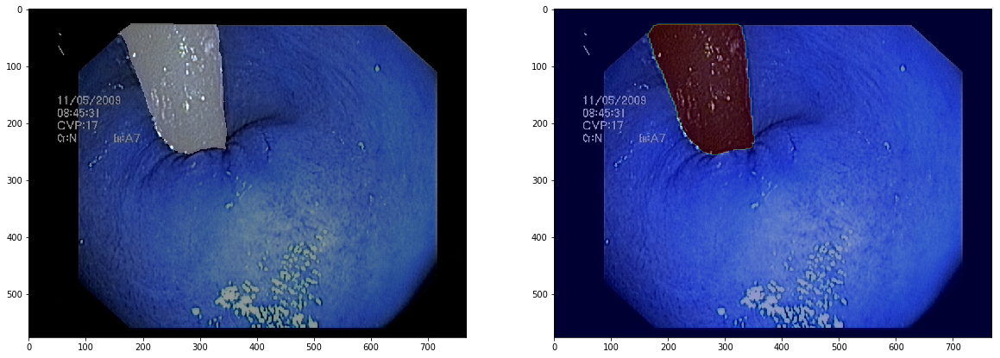

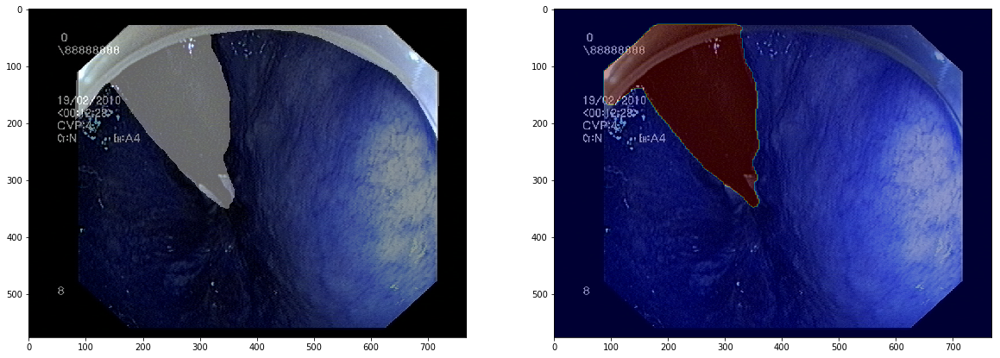

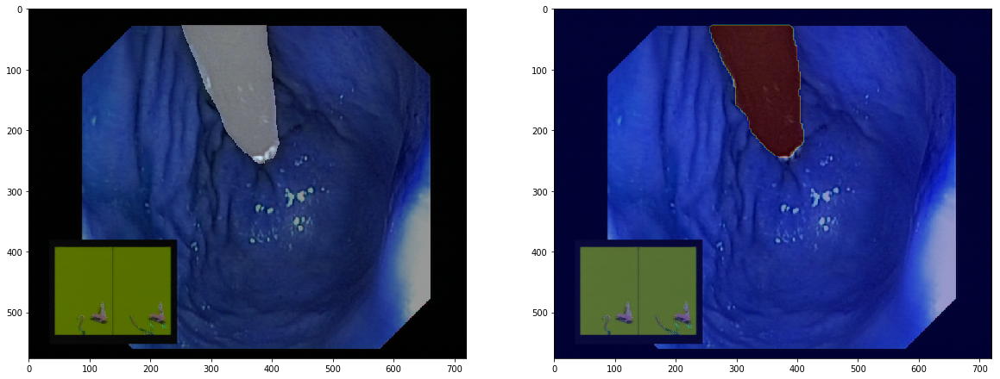

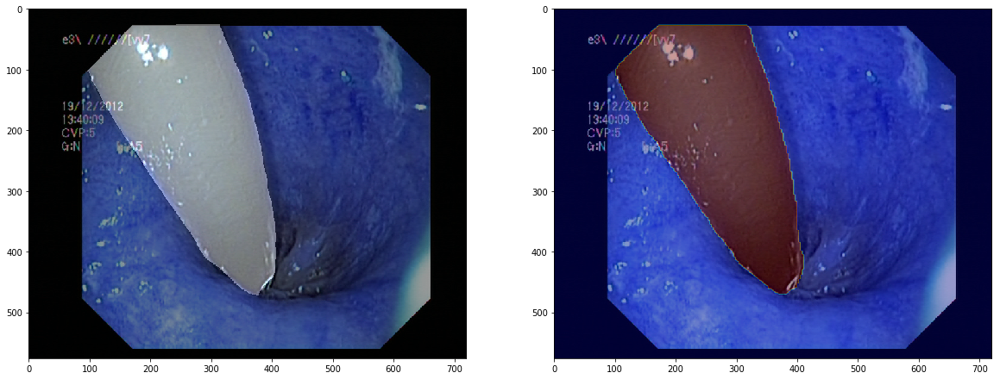

--------------------------------------
Mean validation DICE (on resized data): 0.9467545708778091
Mean validation DICE (on original data): 0.9403071480956834
--------------------------------------
Mean validation Jaccard (on resized data): 0.287549240775352
Mean validation Jaccard (on original data): 0.28114371153957673
--------------------------------------
Runtime: 0.2149043083190918 sec
Epoch 1/35
18/17 [==============================] - 51s 3s/step - loss: 0.8303 - jacard_coef: 0.1697 - dice_coef: 0.6851 - val_loss: 0.9236 - val_jacard_coef: 0.0893 - val_dice_coef: 0.3179
Epoch 2/35
18/17 [==============================] - 11s 611ms/step - loss: 0.6858 - jacard_coef: 0.3142 - dice_coef: 0.8660 - val_loss: 0.9001 - val_jacard_coef: 0.1008 - val_dice_coef: 0.3451
Epoch 3/35
18/17 [==============================] - 18s 1s/step - loss: 0.4752 - jacard_coef: 0.5248 - dice_coef: 0.9628 - val_loss: 0.8606 - val_jacard_coef: 0.1416 - val_dice_coef: 0.5441
Epoch 4/35
18/17 [================

/opt/conda/lib/python3.6/site-packages/sklearn/metrics/classification.py:778: UndefinedMetricWarning: Jaccard is ill-defined and being set to 0.0 in labels with no true or predicted samples.
  'true or predicted', average, ('jaccard',))


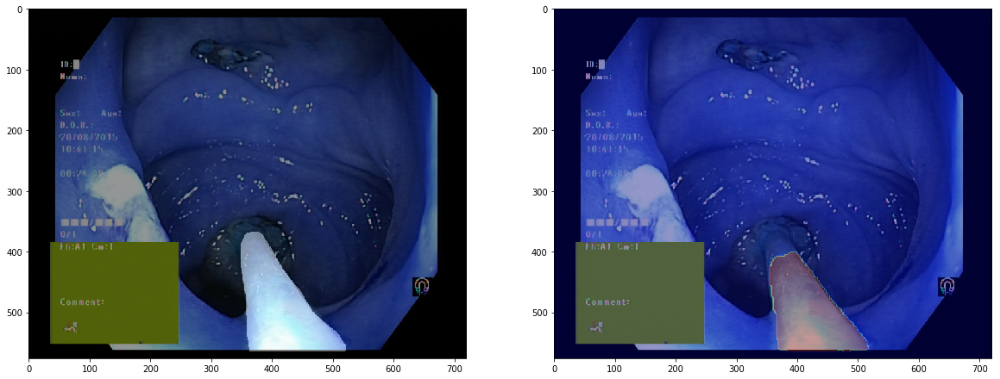

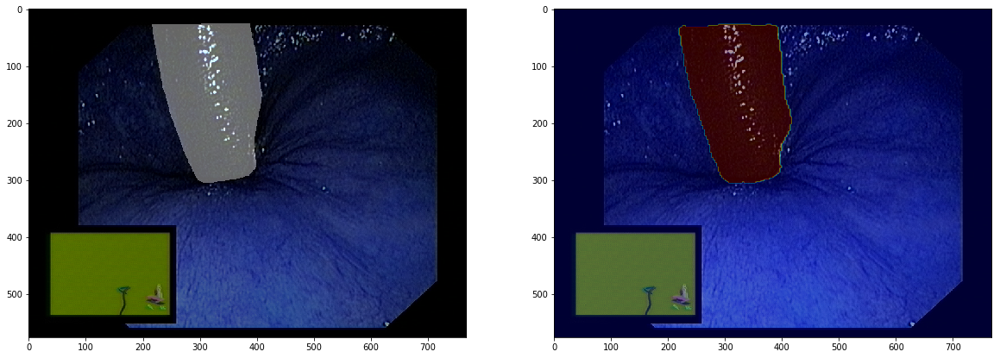

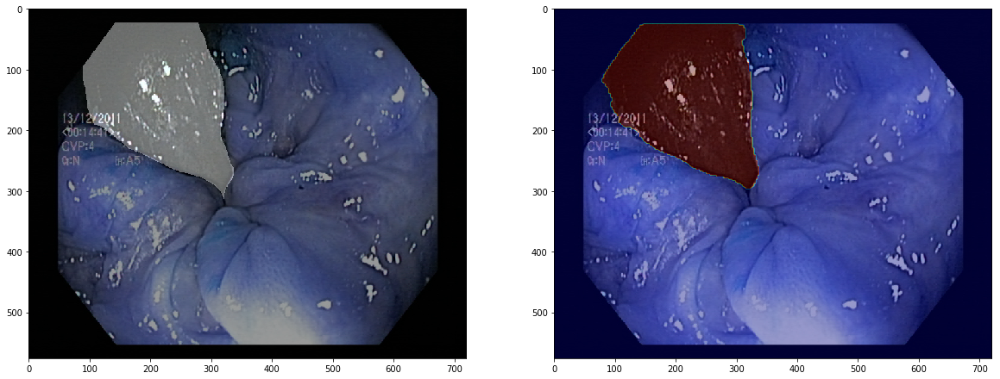

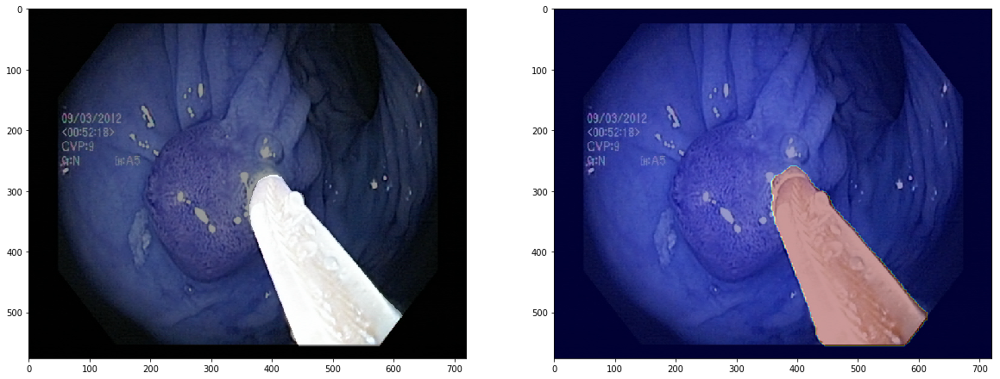

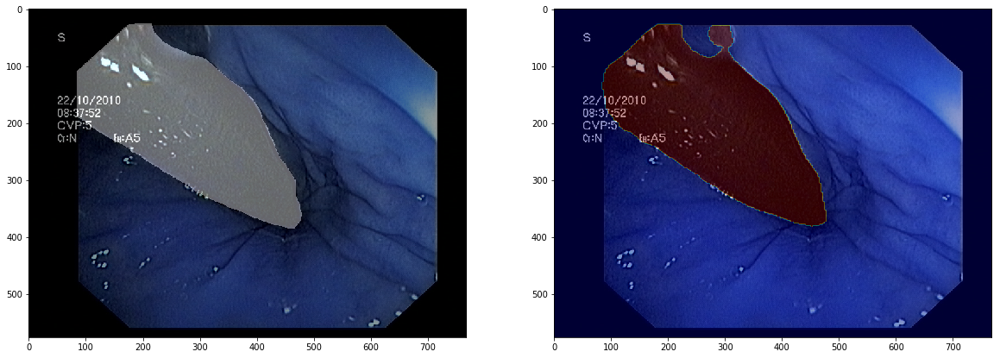

--------------------------------------
Mean validation DICE (on resized data): 0.9602718821284764
Mean validation DICE (on original data): 0.9516357500397638
--------------------------------------
Mean validation Jaccard (on resized data): 0.2699436401655185
Mean validation Jaccard (on original data): 0.2627915447769445
--------------------------------------
Runtime: 0.22527360916137695 sec
Epoch 1/35
18/17 [==============================] - 52s 3s/step - loss: 0.8271 - jacard_coef: 0.1729 - dice_coef: 0.6894 - val_loss: 0.9123 - val_jacard_coef: 0.0894 - val_dice_coef: 0.3212
Epoch 2/35
18/17 [==============================] - 11s 615ms/step - loss: 0.6539 - jacard_coef: 0.3461 - dice_coef: 0.8888 - val_loss: 0.9112 - val_jacard_coef: 0.0898 - val_dice_coef: 0.3326
Epoch 3/35
18/17 [==============================] - 18s 1s/step - loss: 0.4218 - jacard_coef: 0.5782 - dice_coef: 0.9731 - val_loss: 0.8780 - val_jacard_coef: 0.1256 - val_dice_coef: 0.5438
Epoch 4/35
18/17 [===============

/opt/conda/lib/python3.6/site-packages/sklearn/metrics/classification.py:778: UndefinedMetricWarning: Jaccard is ill-defined and being set to 0.0 in labels with no true or predicted samples.
  'true or predicted', average, ('jaccard',))


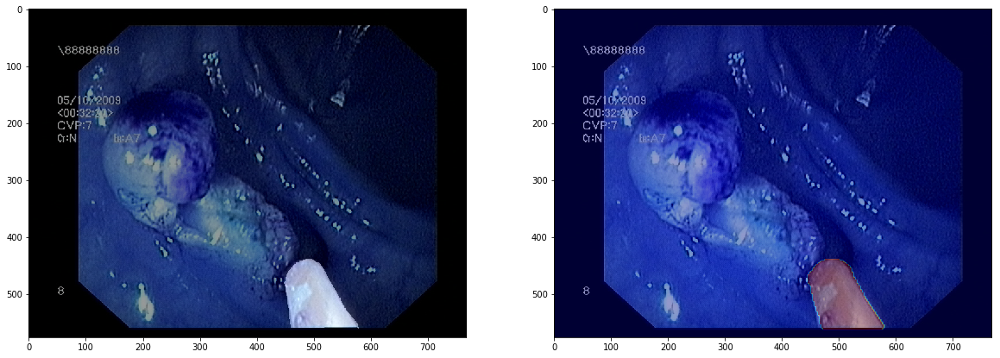

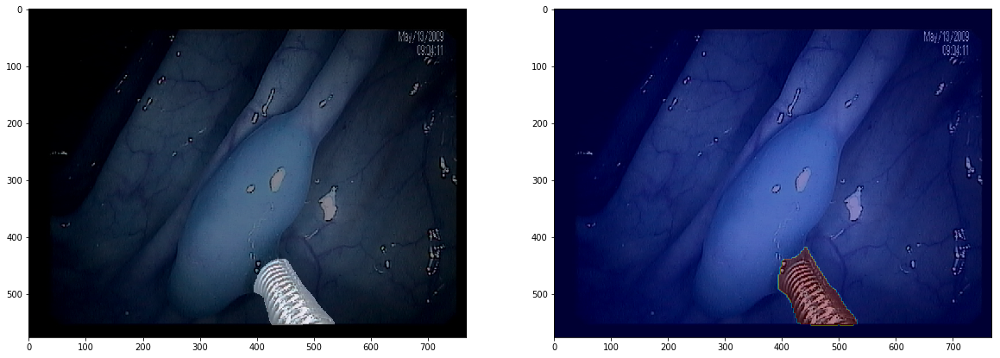

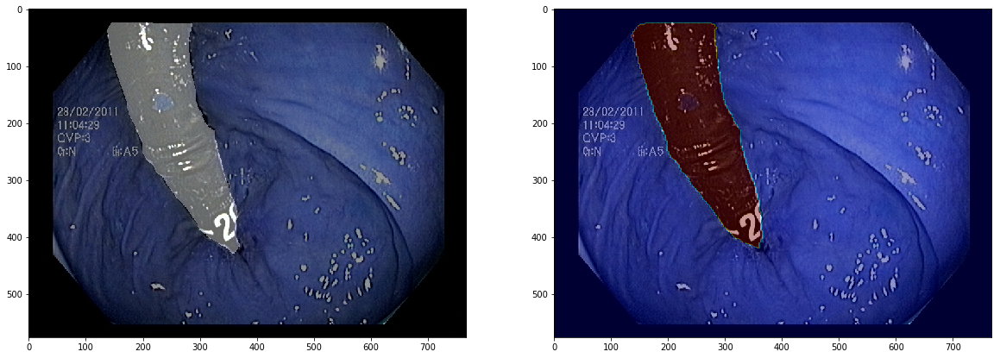

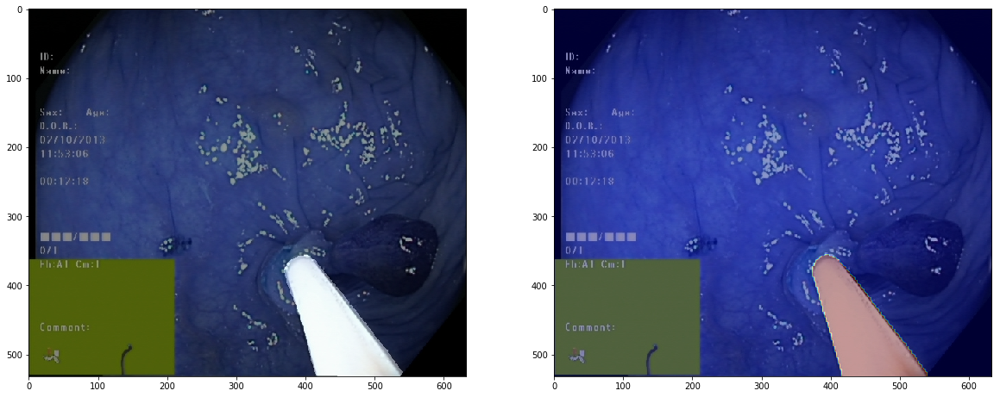

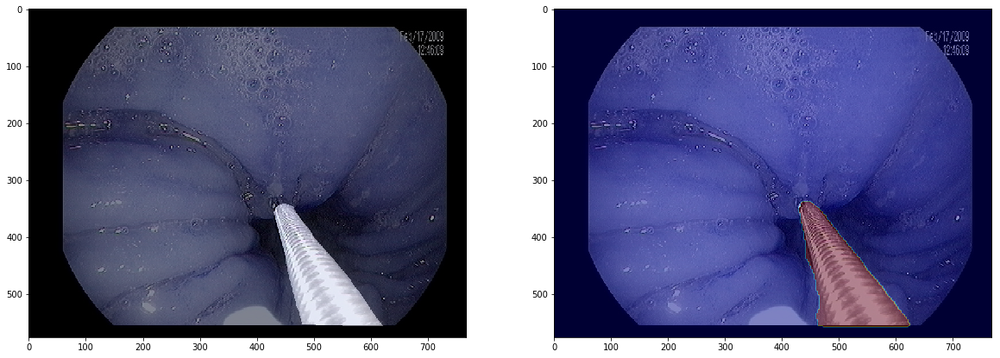

--------------------------------------
Mean validation DICE (on resized data): 0.9507342024351919
Mean validation DICE (on original data): 0.9449709363065859
--------------------------------------
Mean validation Jaccard (on resized data): 0.2705381687390593
Mean validation Jaccard (on original data): 0.2651602774255533
--------------------------------------
Runtime: 0.13787508010864258 sec
Epoch 1/35
18/17 [==============================] - 53s 3s/step - loss: 0.8451 - jacard_coef: 0.1549 - dice_coef: 0.6576 - val_loss: 0.8810 - val_jacard_coef: 0.1151 - val_dice_coef: 0.3838
Epoch 2/35
18/17 [==============================] - 11s 621ms/step - loss: 0.7281 - jacard_coef: 0.2719 - dice_coef: 0.8307 - val_loss: 0.7494 - val_jacard_coef: 0.2428 - val_dice_coef: 0.7568
Epoch 3/35
18/17 [==============================] - 19s 1s/step - loss: 0.5129 - jacard_coef: 0.4871 - dice_coef: 0.9531 - val_loss: 0.5572 - val_jacard_coef: 0.4400 - val_dice_coef: 0.9067
Epoch 4/35
18/17 [===============

/opt/conda/lib/python3.6/site-packages/sklearn/metrics/classification.py:778: UndefinedMetricWarning: Jaccard is ill-defined and being set to 0.0 in labels with no true or predicted samples.
  'true or predicted', average, ('jaccard',))


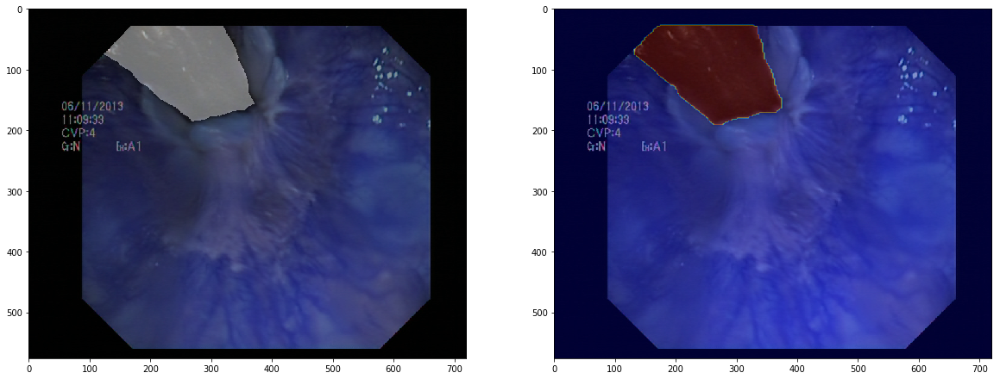

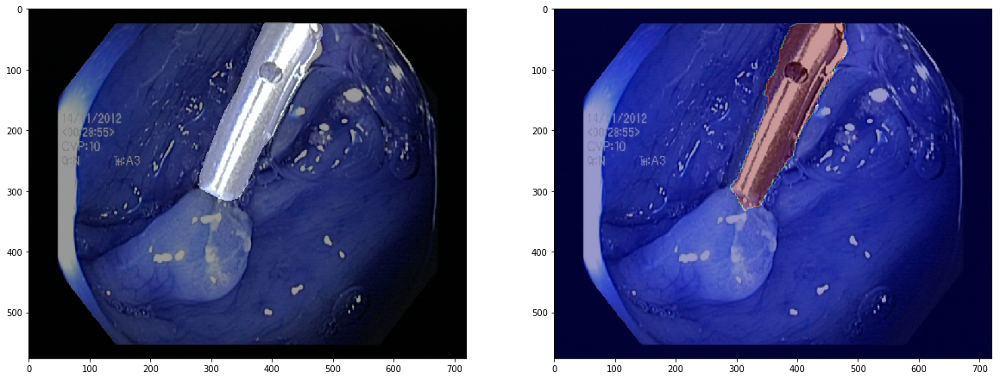

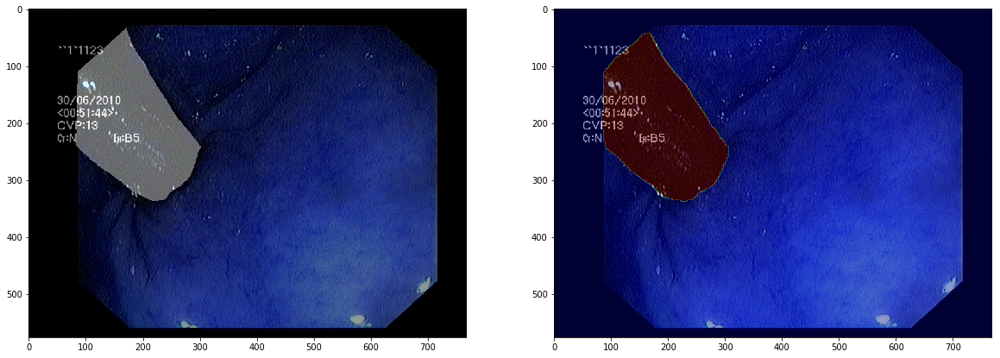

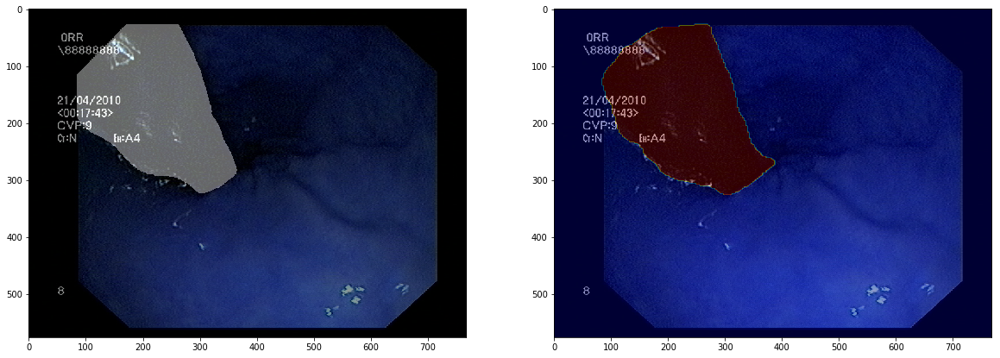

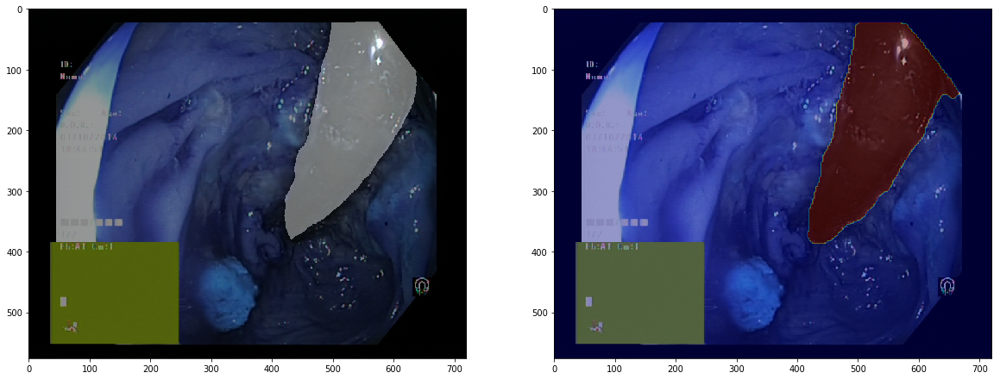

--------------------------------------
Mean validation DICE (on resized data): 0.956149766252064
Mean validation DICE (on original data): 0.9509488328931202
--------------------------------------
Mean validation Jaccard (on resized data): 0.2889967154432055
Mean validation Jaccard (on original data): 0.2837244568331159
--------------------------------------
Runtime: 0.12302207946777344 sec
Shutting down background jobs, please wait a moment...
Done!


Waiting for the remaining 30 operations to synchronize with Neptune. Do not kill this process.


All 30 operations synced, thanks for waiting!


In [15]:
file_list = np.asarray(os.listdir("../input/kvasir-instrument-segmentation/kvasir-instrument/images/images"))
image_path = "../input/kvasir-instrument-segmentation/kvasir-instrument/images/images/" 
mask_path = "../input/kvasir-instrument-segmentation/kvasir-instrument/masks/masks/"

run = neptune.init(project='SSCP/HyperKvasir',
                   api_token='eyJhcGlfYWRkcmVzcyI6Imh0dHBzOi8vYXBwLm5lcHR1bmUuYWkiLCJhcGlfdXJsIjoiaHR0cHM6Ly9hcHAubmVwdHVuZS5haSIsImFwaV9rZXkiOiIzMGUyN2Q2ZS05MjVkLTRlMzItODYwZS0yODQ3ZWU3ZTdmMmEifQ==') # your credentials
# Bjørns token
# eyJhcGlfYWRkcmVzcyI6Imh0dHBzOi8vYXBwLm5lcHR1bmUuYWkiLCJhcGlfdXJsIjoiaHR0cHM6Ly9hcHAubmVwdHVuZS5haSIsImFwaV9rZXkiOiIzMGUyN2Q2ZS05MjVkLTRlMzItODYwZS0yODQ3ZWU3ZTdmMmEifQ==

# Nefelis token
#eyJhcGlfYWRkcmVzcyI6Imh0dHBzOi8vYXBwLm5lcHR1bmUuYWkiLCJhcGlfdXJsIjoiaHR0cHM6Ly9hcHAubmVwdHVuZS5haSIsImFwaV9rZXkiOiIzMGUyN2Q2ZS05MjVkLTRlMzItODYwZS0yODQ3ZWU3ZTdmMmEifQ==

batchsize = 30
data_size = len(file_list)
num_epoch = 35
splits = 10
kf = KFold(n_splits=splits)
valsize = data_size // splits
trainsize = data_size - valsize

my_model = "efficientnetb1"
data_num = np.arange(data_size)

img_size = (256, 256)
num_classes = 3

validation_dice_original = np.zeros([valsize,splits])
validation_dice_resized = np.zeros([valsize,splits])
validation_jaccard_original = np.zeros([valsize,splits])
validation_jaccard_resized = np.zeros([valsize,splits])
cv_count = 0

run["Dataset"] = "Instrument"
run["Model"] = my_model
run["CV-folds"] = splits
run["Epochs"] = num_epoch
run["Batch size"] = batchsize
run["pretrained"] = "Imagenet"
##########################################################################################
# Check what augmentation techniques you use and say "yes" or "no" in the fields bellow  #
# You can also add new fields                                                            #
##########################################################################################
run["noise"] = "yes"
run["blurring"] = "yes"
run["cropping"] = "no"
run["flipping"] = "yes"
run["rotation"] = "yes"
run["zoom"] = "yes"
run["translation"] = "no"
run["brightness"] = "yes"
run["contrast_hist"] = "no"
run["contrast_adaptive"] = "no"
run["color augmentation"] = "no"
run["saturation"] ="no"
run["horizontal shift"] = "yes"
run["vertical shift"] = "yes"


for train_index, val_index in kf.split(data_num):
    #model = get_model(img_size, num_classes)
    model = sm.Unet(my_model, encoder_weights='imagenet', input_shape=( 256,256, 3), classes=3, activation='sigmoid')
    model.compile(optimizer='Adam', loss=jacard_coef_loss, metrics = [jacard_coef, dice_coef])
    model.fit(x=batch_generator(batchsize, generate_data(file_list[train_index], image_path, mask_path, gen_type = "train")), epochs=num_epoch, 
                            steps_per_epoch=(trainsize/batchsize), 
                            validation_steps=(valsize/batchsize),
                            validation_data=batch_generator(batchsize, generate_data(file_list[val_index], image_path, mask_path, gen_type = "val")), 
                            validation_freq=1, 
                            verbose = 1, 
                            callbacks=[reduce_lr],
                            )
    val_gen  = generate_data_pred(file_list[val_index], image_path, mask_path, gen_type = "val")
    for i in range(valsize):
        time_start = time.time()
        original_img, original_mask, X, y_true = next(val_gen)
        original_shape = original_img.shape
        y_pred = model.predict(np.expand_dims(X,0))
        _,y_pred_thr = cv2.threshold(y_pred[0,:,:,0]*255, 127, 255, cv2.THRESH_BINARY)
        y_pred = (y_pred_thr/255).astype(int)
        dice_resized = dice_score(y_true[:,:,0],y_pred)
        jaccard_resized = jaccard_score(y_true[:,:,0],y_pred, average="macro")
        
        y_pred_original = cv2.resize(y_pred.astype(float), (original_shape[1],original_shape[0]), interpolation= cv2.INTER_LINEAR)
        dice_original = dice_score(original_mask[:,:,0],y_pred_original.astype(int)*255)
        jaccard_original = jaccard_score(original_mask[:,:,0],y_pred_original.astype(int)*255, average="macro")
        
        validation_dice_original[i,cv_count] = dice_original
        validation_dice_resized[i,cv_count] = dice_resized
        validation_jaccard_original[i,cv_count] = jaccard_original
        validation_jaccard_resized[i,cv_count] = jaccard_resized
        
        if i < 5:
            plt.figure(figsize=(20,10))
            plt.subplot(1,2,1)
            plt.imshow(original_img, 'gray', interpolation='none')
            plt.imshow(original_mask/255.0, 'jet', interpolation='none', alpha=0.4)
            plt.subplot(1,2,2)
            plt.imshow(original_img, 'gray', interpolation='none')
            plt.imshow(y_pred_original, 'jet', interpolation='none', alpha=0.4)
            plt.show()
            

    dice_resized_mean = validation_dice_resized[:,cv_count].mean()
    dice_original_mean = validation_dice_original[:,cv_count].mean()
    jaccard_resized_mean = validation_jaccard_resized[:,cv_count].mean()
    jaccard_original_mean = validation_jaccard_original[:,cv_count].mean()
        
    print("--------------------------------------")
    print("Mean validation DICE (on resized data):", dice_resized_mean) 
    print("Mean validation DICE (on original data):", dice_original_mean)
    print("--------------------------------------")
    print("Mean validation Jaccard (on resized data):", jaccard_resized_mean) 
    print("Mean validation Jaccard (on original data):", jaccard_original_mean)
    print("--------------------------------------")
    run["Dice Resized"].log(dice_resized_mean)
    run["Dice Original"].log(dice_original_mean)
    run["Jaccard Resized"].log(jaccard_resized_mean)
    run["Jaccard Original"].log(jaccard_original_mean)
    runtime = time.time() - time_start 
    print('Runtime: {} sec'.format(runtime))
    run["Runtime"] = runtime
    cv_count +=1
run.stop()